# Udacity Self-Driving Car Engineer Nanodegree
## Project 4: Advanced Lane Finding

## Import Packages

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline

## Step 1: Camera Calibrating
For this section when calibrating the camera using chessboard images, I mainly referenced the code given in class as a start point.

### 1. Find corners of chessboard image

Before test on actual road images, the chessboard images are used to test camera calibration. I used `glob` to iterate over all the chessboard images in `camera_cal`

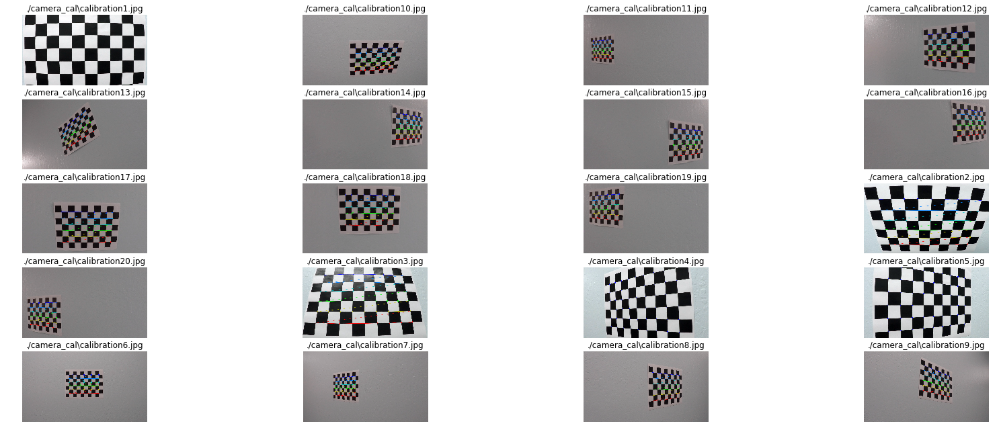

In [2]:
# Read in chessbord images
imgs = glob.glob('./camera_cal/calibration*.jpg')

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Prepare object points
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2) # x,y coordinates

# For visualization
fig, axs = plt.subplots(5,4, figsize=(24, 9))
fig.tight_layout()
axs = axs.ravel()
fig.subplots_adjust(hspace = .2, wspace=.001)

# Search for chessboard corners for each image
for i, fname in enumerate(imgs):
    
    # read in ith image
    img = cv2.imread(fname)
        
    # Convert image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # Find chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    # If corners are found, add object points, image points
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        
    # Draw and display the corners
    img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
    axs[i].axis('off')
    axs[i].imshow(img)
    axs[i].set_title('{}'.format(fname))

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["objpoints"] = objpoints
dist_pickle["imgpoints"] = imgpoints
pickle.dump( dist_pickle, open( "calibration.p", "wb" ) )

**Note:** From the results, we can see that for image 'calibration1, calibration4, and calibration5' no chess corners are found.

### 2. Chessboard image calibration

Define `cal_undistort` function for camera calibration and test it on chessboard images.

In [3]:
def cal_undistort(img, objpoints, imgpoints):
    
    img_size = (img.shape[1], img.shape[0])
    
    # Camera calibration, given object points, image points, and the shape of the grayscale image
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

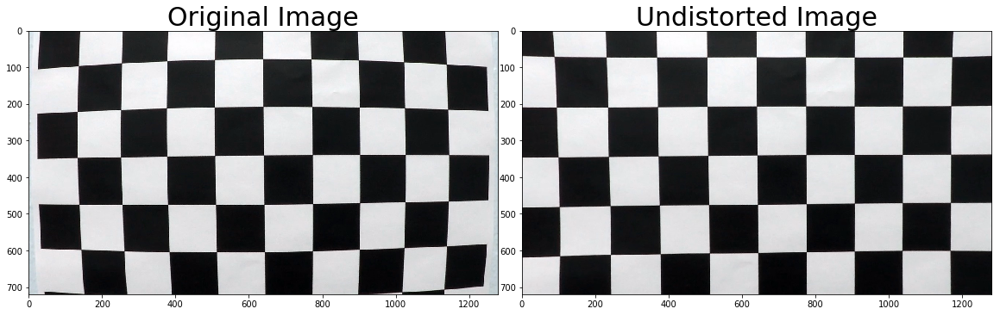

In [4]:
# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

# Read in test image
img = cv2.imread('./camera_cal/calibration1.jpg')

# Performs the camera calibration, image distortion correction
undistorted = cal_undistort(img, objpoints, imgpoints)
    
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=30)

### 3. Camera calibration example image for car camera

Now, the `cal_undistort` function performs good on chessboard images, now we want to test on actual car images.

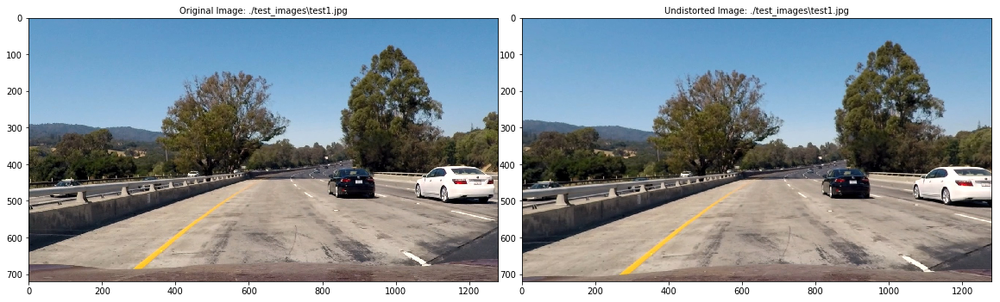

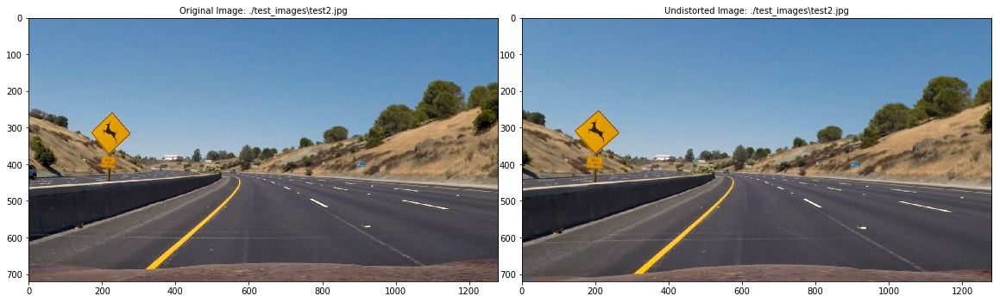

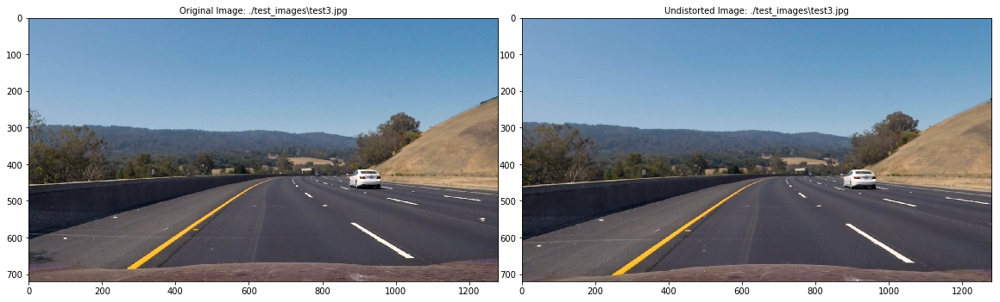

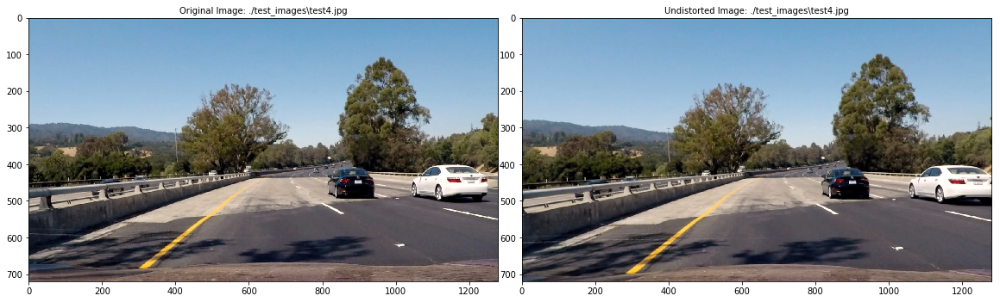

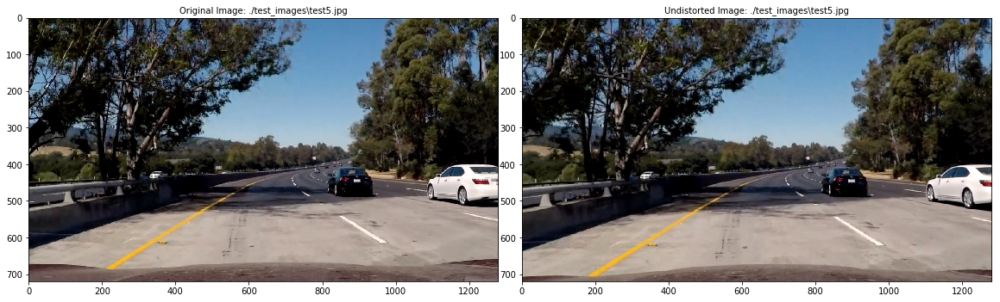

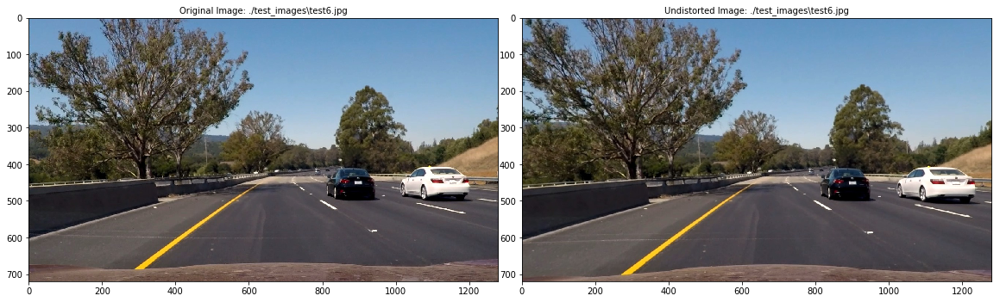

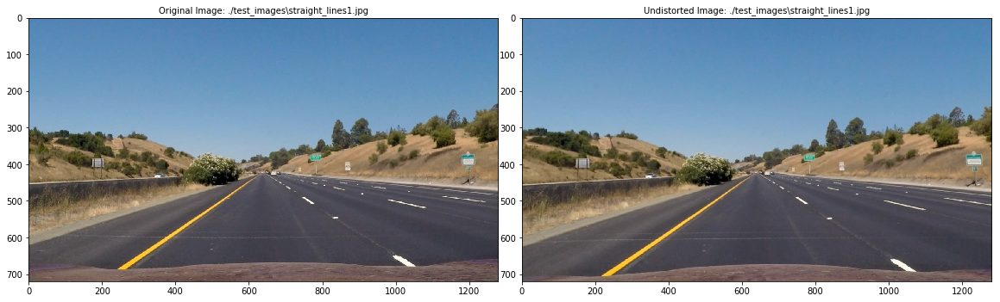

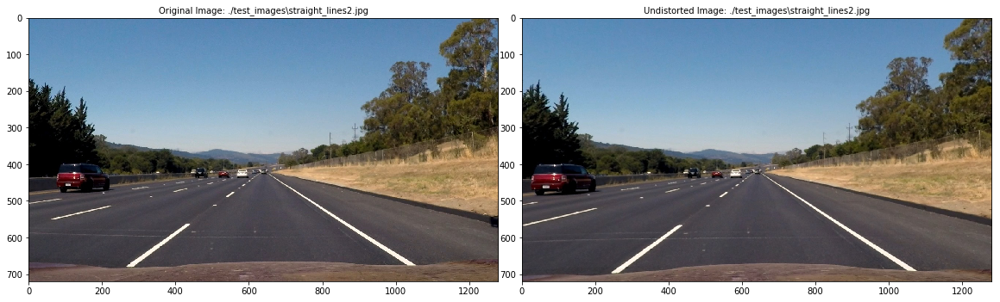

In [5]:
# Read in test images
test_imgs1 = glob.glob('./test_images/test*.jpg')
test_imgs2 = glob.glob('./test_images/straight_lines*.jpg')
test_imgs = test_imgs1 + test_imgs2

for i, fname in enumerate(test_imgs):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Undistort image
    undistorted = cal_undistort(img, objpoints, imgpoints)
    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(img)
    ax1.set_title('Original Image: {}'.format(fname), fontsize=10)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image: {}'.format(fname), fontsize=10)


**Note:** undistort is particularly noticeable by the change in shape of the car hood

## Step 2: Apply Binary Thresholds

In this step I attempted to convert the undistorted image to different color spaces and try out combinations with different color and gradient thresholds to enerate a binary image where the lane lines are clearly visibel. From this step on, i will mainly perform the processing pipeline tuning on image 'straight_line1'(stright line helps determine destination point and source point later for perspective transform, and yellow lines is where I have problem detecting in Project 1) and 'test4'(image with curved lines, tree shadows and yellow lines, most complicated one).

### 1. Gradient threshold

#### Threshold functions
In tis section, I will first define each threshold function seperately

In [6]:
# Note: img for following functions is the undistorted image
# Sobel x or y threshold
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    # Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    
    # Take the absolute value of the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
        
    # Scale to 8-bit (0-255) then convert to type=np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    
    # Create a mask of 1's where the scaled gradient magnitude is > thresh_min and < thresh_max
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return binary_output

# Magnitude threshold
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    return binary_output

# Direction of Gradient threshold
def dir_threshold(img, sobel_kernel=3, thresh=(0.7, 1.3)):
    
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Take the gradient in x and y separately
    abs_sobel_x = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    abs_sobel_y = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0 ,1, ksize=sobel_kernel))
    
    # Calculate the direction of the gradient 
    dir_grad = np.arctan2(abs_sobel_y, abs_sobel_x)
    
    # Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(dir_grad)
    binary_output[(dir_grad >= thresh[0]) & (dir_grad <= thresh[1])] = 1
    
    return binary_output

#### Combining thresholds

Combine the selected thresholds functions.

In [7]:
# Combining all thresholds
def combine_thresh(img):
    
   # Choose a Sobel kernel size
    ksize = 15 # Choose a larger odd number to smooth gradient measurements
    
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(undist, orient='x', sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = mag_thresh(undist, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(undist, sobel_kernel=ksize, thresh=(0.7, 1.4))
    
    # Combine the gradient, magnitude and direction thresholds.
    combined = np.zeros_like(dir_binary)
    combined[(gradx == 1) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    return combined

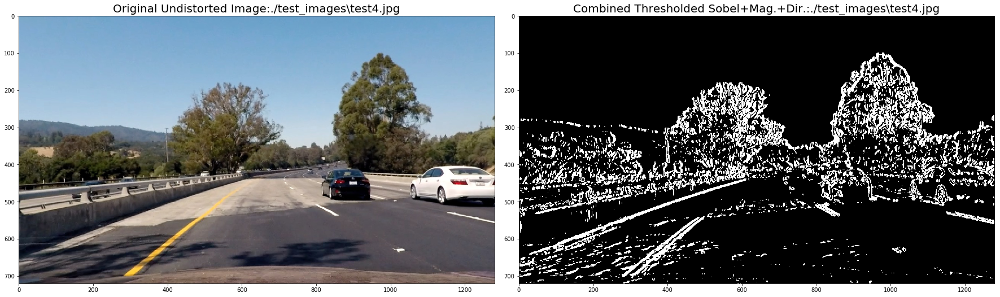

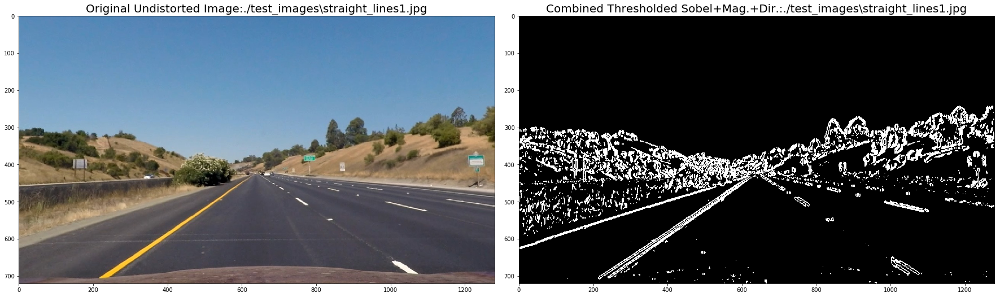

In [8]:
imgs = ['./test_images\\test4.jpg', './test_images\\straight_lines1.jpg']

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

for i, fname in enumerate(imgs):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Undistort image
    undist = cal_undistort(img, objpoints, imgpoints)
    
    # Apply Binary Thershold
    combined = combine_thresh(undist)

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(undist)
    ax1.set_title('Original Undistorted Image:{}'.format(fname), fontsize=20)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Combined Thresholded Sobel+Mag.+Dir.:{}'.format(fname), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 2. Color Space
Only gradient threshold alone is not enough, the yellow line in 'test4' image is not well detected. So we apply color space threshold

In [9]:
def color_thresh(img):
    # Note: img is the undistorted image    
    # R & G thresholds so that yellow lanes are detected well.
    color_threshold = 150
    R = img[:,:,0]
    G = img[:,:,1]
    r_g_condition = np.zeros_like(R)
    r_g_condition[(R > color_threshold) & (G > color_threshold)] = 1
    
    # Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    
    # Seperate H,L,S channel
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    # S channel performs well for detecting bright yellow and white lanes
    s_thresh = (100, 255)
    binary_s = np.zeros_like(s_channel)
    binary_s[(s_channel > s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # L channel performs well for avoiding pixels which have shadows and as a result darker.
    l_thresh = (120, 255)
    binary_l = np.zeros_like(l_channel)
    binary_l[(l_channel > l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    return binary_s, binary_l, r_g_condition

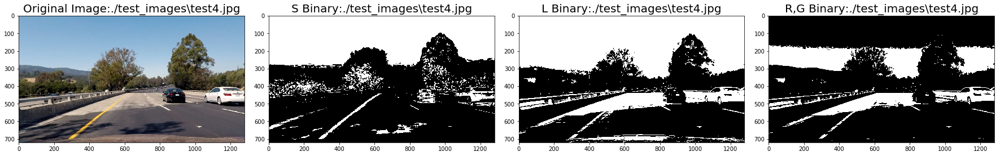

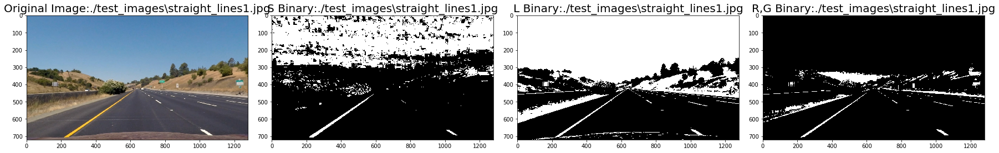

In [10]:
imgs = ['./test_images\\test4.jpg', './test_images\\straight_lines1.jpg']

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

for i, fname in enumerate(imgs):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    undist = cal_undistort(img, objpoints, imgpoints)

    binary_s, binary_l, r_g_condition = color_thresh(undist)

    # Plot the result
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(undist)
    ax1.set_title('Original Image:{}'.format(fname), fontsize=20)

    ax2.imshow(binary_s,cmap='gray')
    ax2.set_title('S Binary:{}'.format(fname), fontsize=20)

    ax3.imshow(binary_l,cmap='gray')
    ax3.set_title('L Binary:{}'.format(fname), fontsize=20)

    ax4.imshow(r_g_condition,cmap='gray')
    ax4.set_title('R,G Binary:{}'.format(fname), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


### 3. Combine Color and Gradient

Here we combine the binary threshold from color space and gradient, by obersvation a lane should either be yellowish or whiteish and it should also have gradient.

In [11]:
def color_grad_thresh(img):
    
    # Gradient
    combined_grad = combine_thresh(img)
    
    # Color space
    binary_s, binary_l, r_g_condition = color_thresh(img)
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(binary_s)
    combined_binary[((r_g_condition ==1) & (binary_l == 1)) & ((binary_s == 1) | (combined_grad == 1))] = 1
    
    return combined_binary

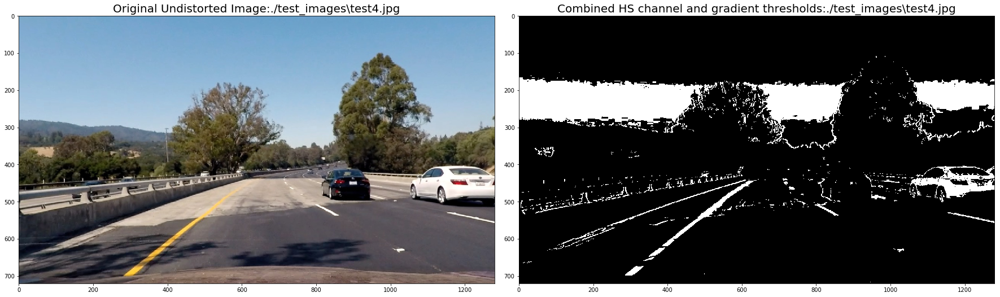

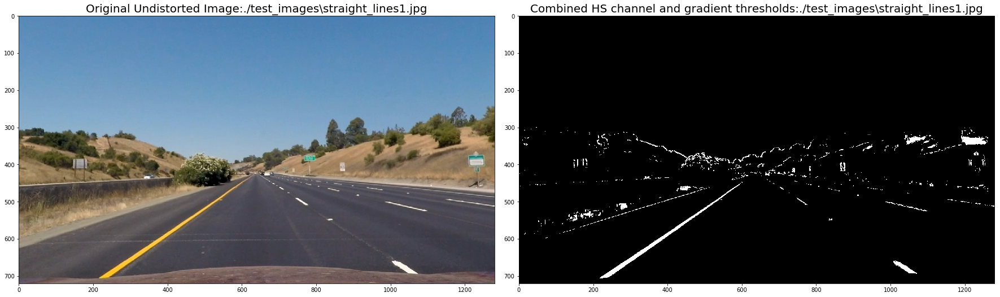

In [12]:
imgs = ['./test_images\\test4.jpg', './test_images\\straight_lines1.jpg']

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

for i, fname in enumerate(imgs):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    undist = cal_undistort(img, objpoints, imgpoints)

    combined_binary = color_grad_thresh(undist)

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(undist)
    ax1.set_title('Original Undistorted Image:{}'.format(fname), fontsize=20)
    ax2.imshow(combined_binary, cmap='gray')
    ax2.set_title('Combined HS channel and gradient thresholds:{}'.format(fname), fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

**Note:** After applied Color/gradient threshold, the lane lines are clearly visible. There are still some noises detect, but they can be eliminated by perspective transform.

## Step 3: Perspective Transform

### 1. Define perspective transform function

Apply a perspective transform by choosing four source points manually

In [13]:
# Define a function that takes an image and performs perspective tranform
def corners_unwarp(img, src, dst):
    
    # Grab the image shape
    img_size = (img.shape[1], img.shape[0])
      
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size)

    # Return the resulting image and matrix
    return warped, M

#### 2. Perspective Transform for straight line

The first step is to investigate an image where the lane lines are straight, here I used straight_lines1.jpg, and find four points lying along the lines that, after perspective transform, make the lines look straight and vertical from a bird's eye view perspective.

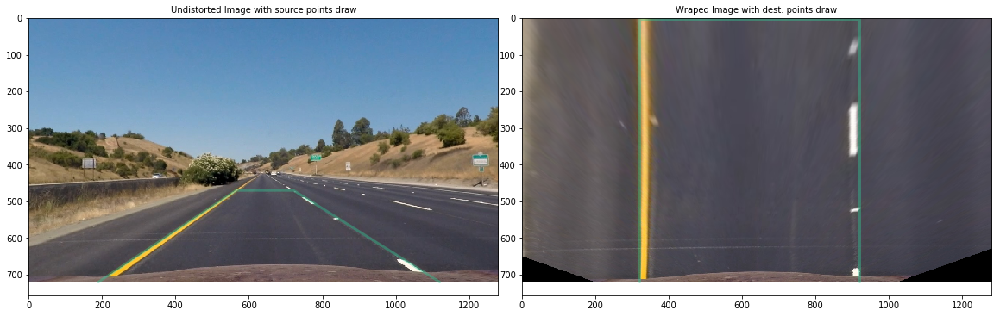

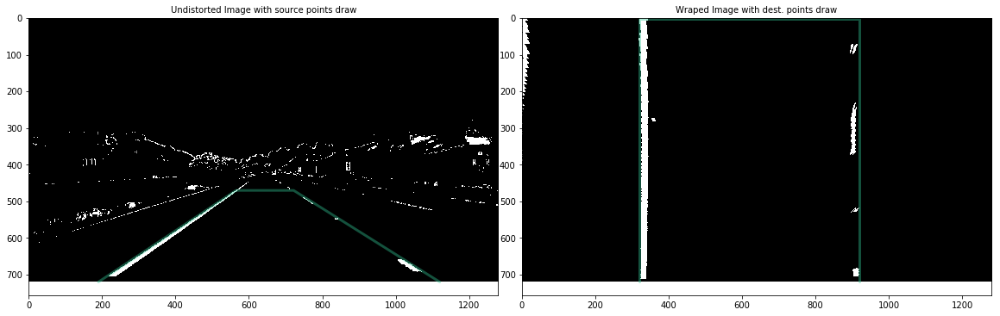

In [14]:
img = cv2.imread('./test_images/straight_lines1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

undist = cal_undistort(img, objpoints, imgpoints)

combined_binary = color_grad_thresh(undist)

# Source points
src = np.float32([[565, 470],[722, 470], [1120, 720],[190, 720]])
    
# Destination points
dst = np.float32([[320, 1], [920, 1], [920, 720],[320, 720]])

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["src"] = src
dist_pickle["dst"] = dst
pickle.dump( dist_pickle, open( "src_dst.p", "wb" ) )

# Perspective transform
warped_thresh, M_thresh = corners_unwarp(combined_binary, src, dst)
warped_undist, M_undist = corners_unwarp(undist, src, dst)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(undist, cmap='gray')
x = [src[3][0],src[0][0],src[1][0],src[2][0]]
y = [src[3][1],src[0][1],src[1][1],src[2][1]]
ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax1.set_title('Undistorted Image with source points draw', fontsize=10)
ax2.imshow(warped_undist, cmap='gray')
x = [dst[3][0],dst[0][0],dst[1][0],dst[2][0]]
y = [dst[3][1],dst[0][1],dst[1][1],dst[2][1]]
ax2.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax2.set_title('Wraped Image with dest. points draw', fontsize=10)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(combined_binary, cmap='gray')
x = [src[3][0],src[0][0],src[1][0],src[2][0]]
y = [src[3][1],src[0][1],src[1][1],src[2][1]]
ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax1.set_title('Undistorted Image with source points draw', fontsize=10)
ax2.imshow(warped_thresh, cmap='gray')
x = [dst[3][0],dst[0][0],dst[1][0],dst[2][0]]
y = [dst[3][1],dst[0][1],dst[1][1],dst[2][1]]
ax2.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax2.set_title('Wraped Image with dest. points draw', fontsize=10)

**Note:**  The resulted bird's eye lanes are pretty straight.

#### 3. Perspective Transform for curved line

The same four source points are applied to transform a curved lane image. The test of whether or not the transform is correct, is that the lane lines should appear parallel in the warped images even though the lines are curved.

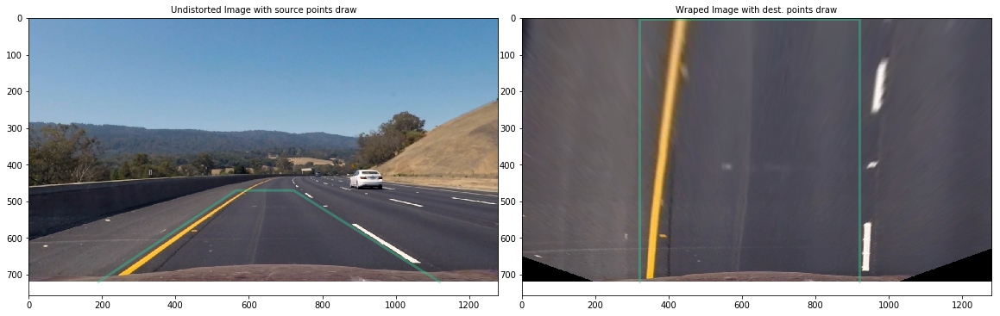

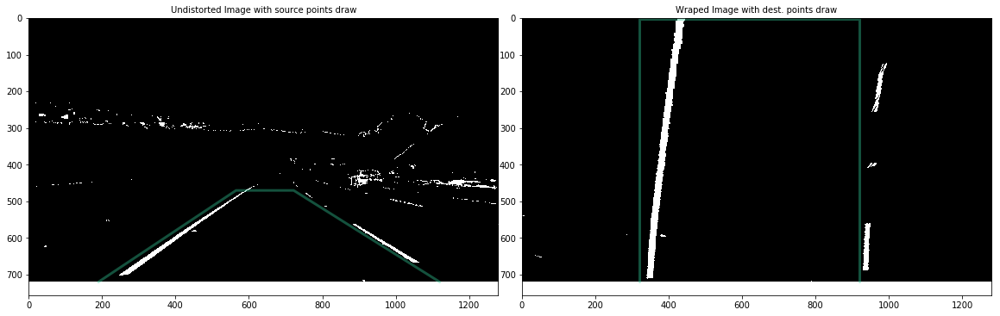

In [15]:
img = cv2.imread('./test_images/test3.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

undist = cal_undistort(img, objpoints, imgpoints)

combined_binary = color_grad_thresh(undist)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "src_dst.p", "rb" ) )
src = dist_pickle["src"]
dst = dist_pickle["dst"]

# Perspective transform
# Perspective transform
warped_thresh, M_thresh = corners_unwarp(combined_binary, src, dst)
warped_undist, M_undist = corners_unwarp(undist, src, dst)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(undist, cmap='gray')
x = [src[3][0],src[0][0],src[1][0],src[2][0]]
y = [src[3][1],src[0][1],src[1][1],src[2][1]]
ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax1.set_title('Undistorted Image with source points draw', fontsize=10)
ax2.imshow(warped_undist, cmap='gray')
x = [dst[3][0],dst[0][0],dst[1][0],dst[2][0]]
y = [dst[3][1],dst[0][1],dst[1][1],dst[2][1]]
ax2.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax2.set_title('Wraped Image with dest. points draw', fontsize=10)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
f.subplots_adjust(hspace = .2, wspace=.05)
ax1.imshow(combined_binary, cmap='gray')
x = [src[3][0],src[0][0],src[1][0],src[2][0]]
y = [src[3][1],src[0][1],src[1][1],src[2][1]]
ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax1.set_title('Undistorted Image with source points draw', fontsize=10)
ax2.imshow(warped_thresh, cmap='gray')
x = [dst[3][0],dst[0][0],dst[1][0],dst[2][0]]
y = [dst[3][1],dst[0][1],dst[1][1],dst[2][1]]
ax2.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
ax2.set_title('Wraped Image with dest. points draw', fontsize=10)

**Note:** the curved lines are (more or less) parallel in the transformed image

#### 4. Perspective transform result of all test figures

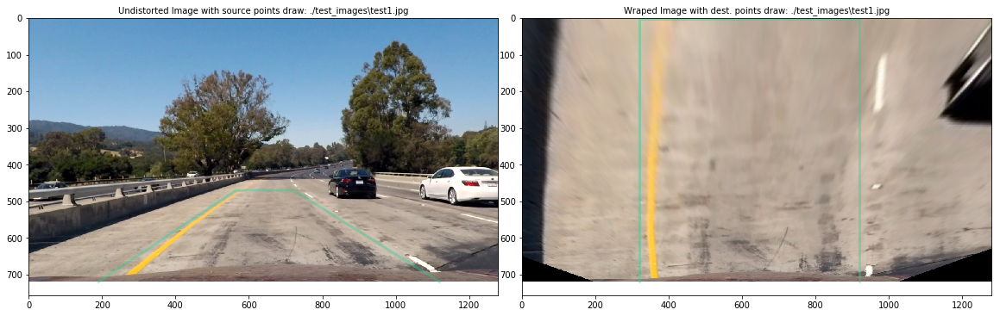

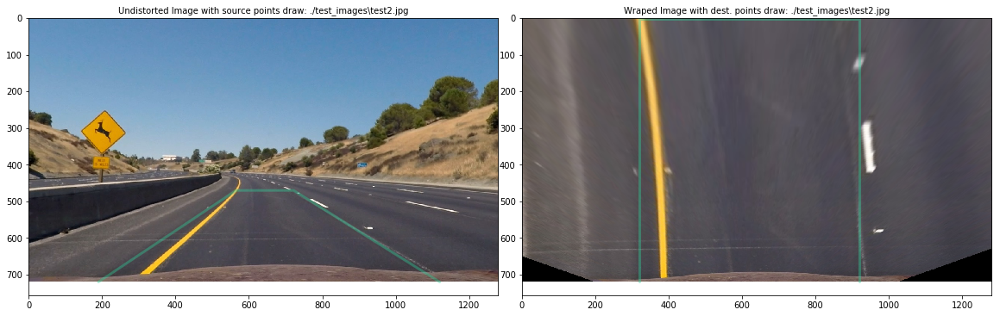

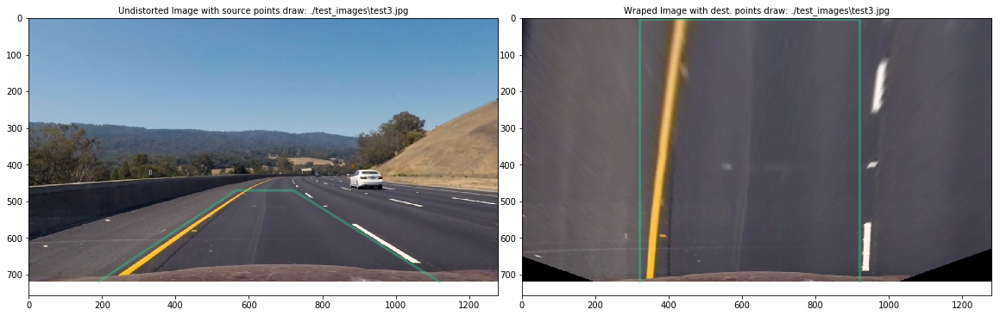

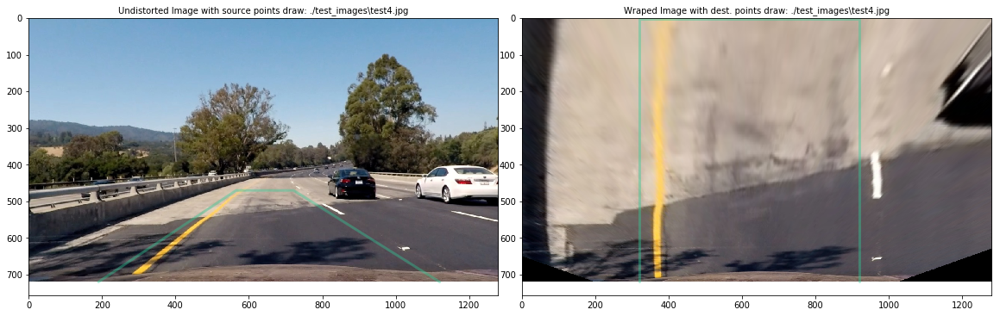

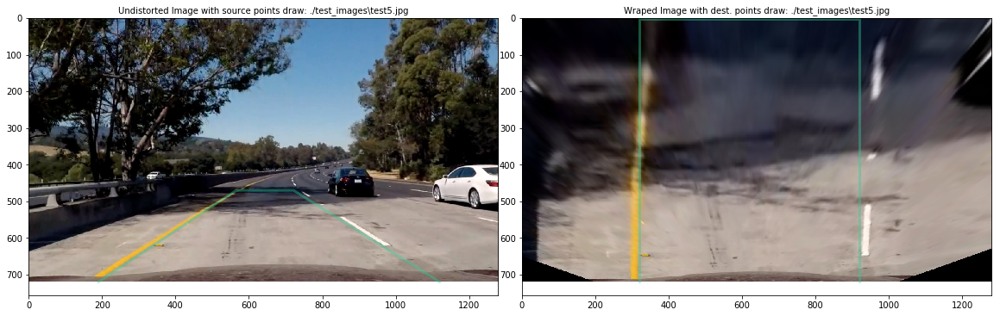

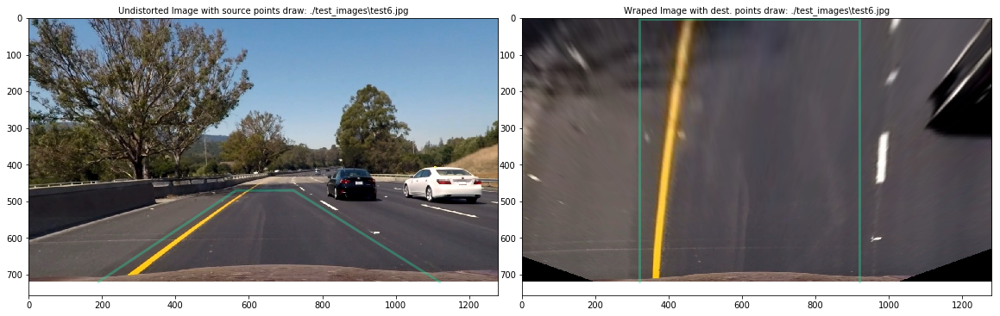

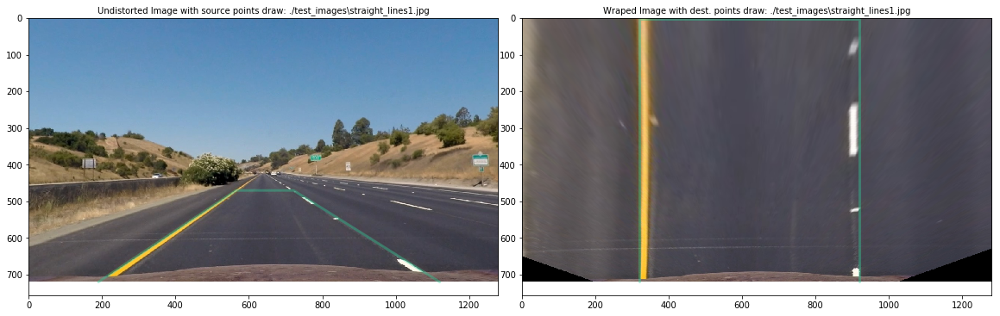

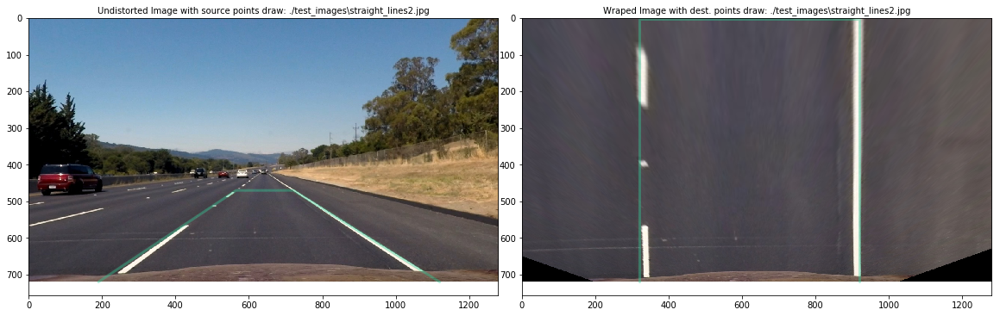

In [16]:
# Read in test images
test_imgs = glob.glob('./test_images/test*.jpg')
test_imgs2 = glob.glob('./test_images/straight_lines*.jpg')
test_imgs = test_imgs1 + test_imgs2

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "src_dst.p", "rb" ) )
src = dist_pickle["src"]
dst = dist_pickle["dst"]

for i, fname in enumerate(test_imgs):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    undist = cal_undistort(img, objpoints, imgpoints)

    # Perspective transform
    warped, M = corners_unwarp(undist, src, dst)
    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(undist)
    x = [src[3][0],src[0][0],src[1][0],src[2][0]]
    y = [src[3][1],src[0][1],src[1][1],src[2][1]]
    ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
    ax1.set_title('Undistorted Image with source points draw: {}'.format(fname), fontsize=10)
    ax2.imshow(warped)
    x = [dst[3][0],dst[0][0],dst[1][0],dst[2][0]]
    y = [dst[3][1],dst[0][1],dst[1][1],dst[2][1]]
    ax2.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
    ax2.set_title('Wraped Image with dest. points draw: {}'.format(fname), fontsize=10)


#### 5. Perspective transform result of all test figures after threshold

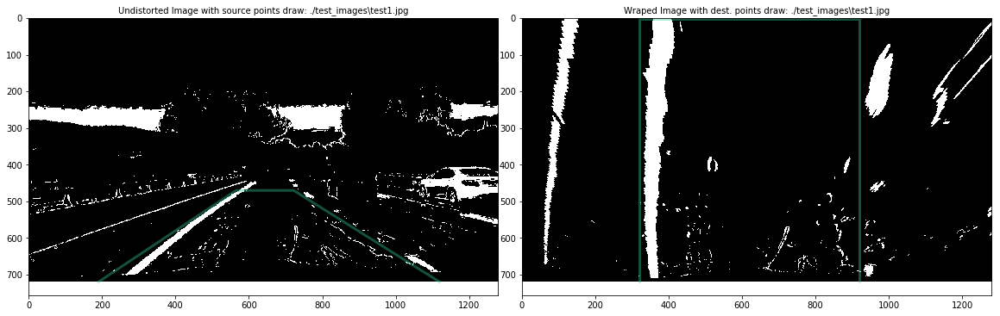

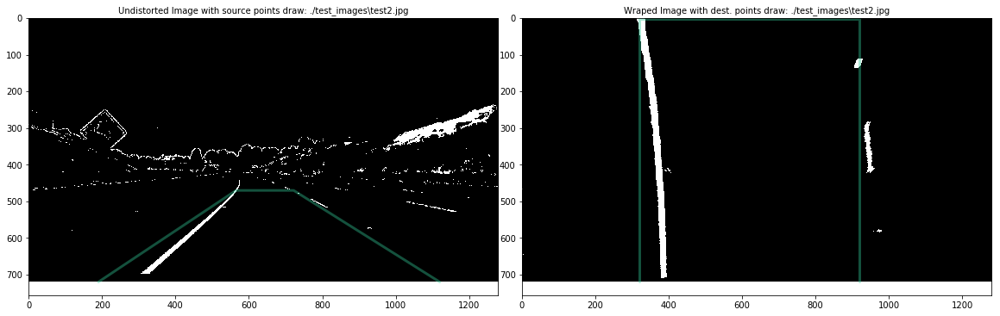

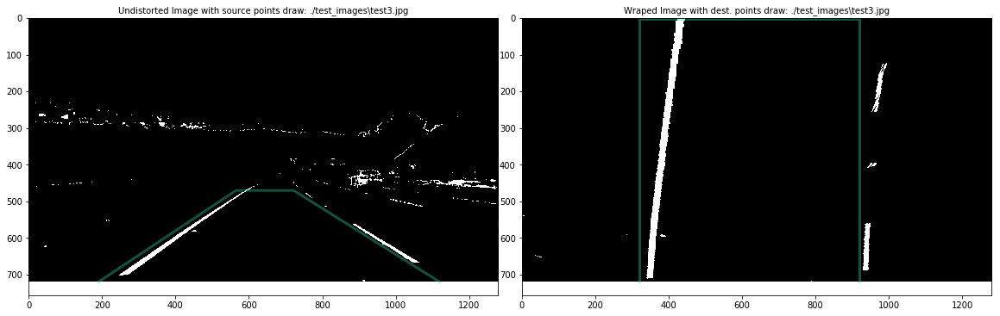

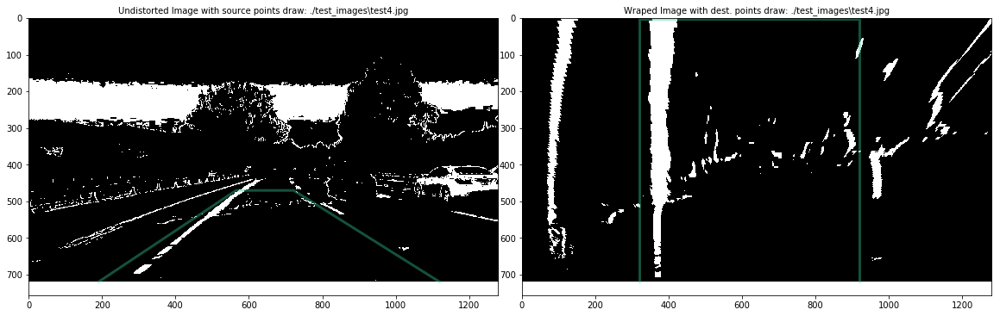

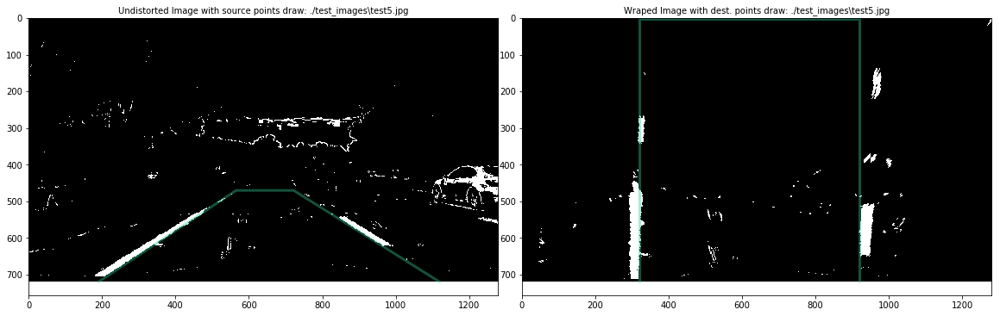

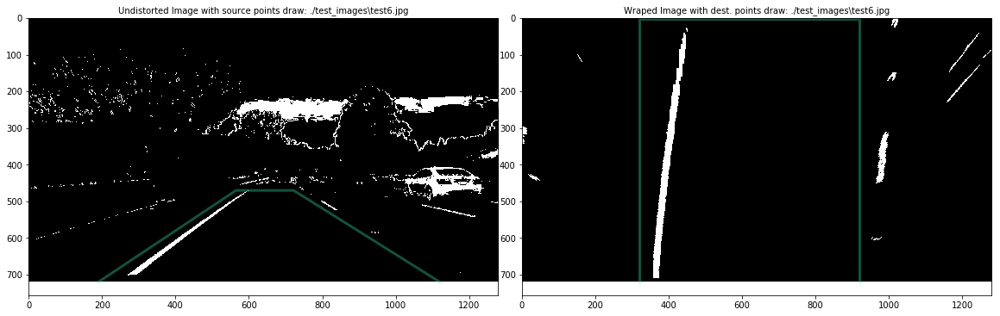

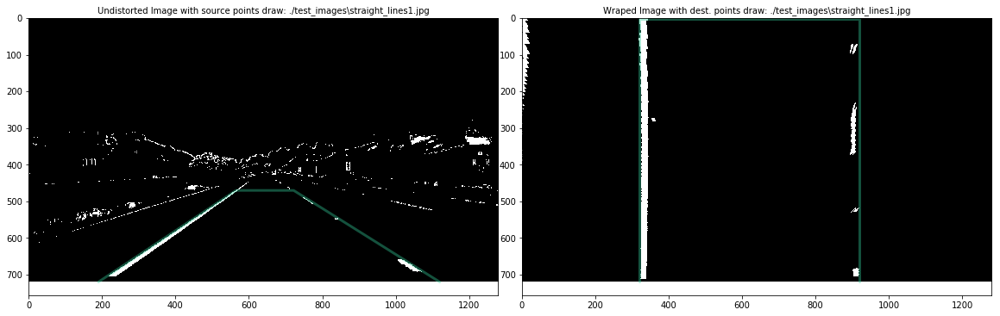

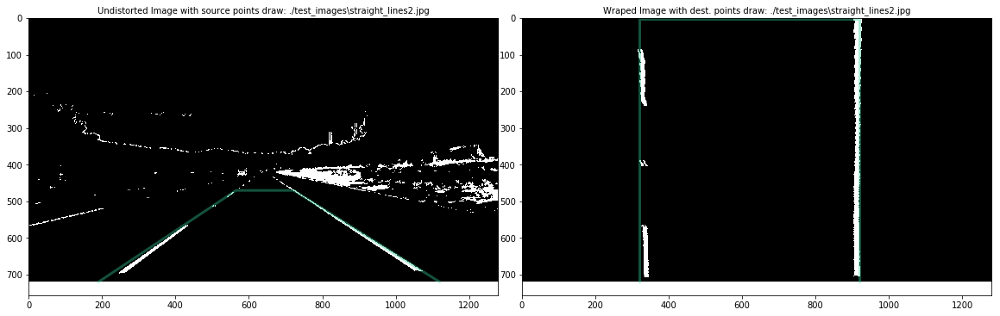

In [17]:
# Read in test images
test_imgs = glob.glob('./test_images/test*.jpg')
test_imgs2 = glob.glob('./test_images/straight_lines*.jpg')
test_imgs = test_imgs1 + test_imgs2

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "src_dst.p", "rb" ) )
src = dist_pickle["src"]
dst = dist_pickle["dst"]

for i, fname in enumerate(test_imgs):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    undist = cal_undistort(img, objpoints, imgpoints)
    combined_binary = color_grad_thresh(undist)

    # Perspective transform
    binary_warped, M = corners_unwarp(combined_binary, src, dst)
    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(combined_binary, cmap='gray')
    x = [src[3][0],src[0][0],src[1][0],src[2][0]]
    y = [src[3][1],src[0][1],src[1][1],src[2][1]]
    ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
    ax1.set_title('Undistorted Image with source points draw: {}'.format(fname), fontsize=10)
    ax2.imshow(binary_warped, cmap='gray')
    x = [dst[3][0],dst[0][0],dst[1][0],dst[2][0]]
    y = [dst[3][1],dst[0][1],dst[1][1],dst[2][1]]
    ax2.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
    ax2.set_title('Wraped Image with dest. points draw: {}'.format(fname), fontsize=10)


## Step 4: Finding Lanes

### Identify lane pixels

#### 1. Sliding Window Polyfit Function

In [35]:
def sliding_window(binary_warped):
    # Take the histogram of the bottom half of the image
    # The peaks in the histogram tell us about the likely position of the lane pixels in the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Choose the number of sliding windows
    nwindows = 10
    
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # Set the width of the windows +/- margin
    margin = 80
    
    # Set minimum number of pixels found to recenter window
    minpix = 40
    
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Rectangle data for visualization
    rectangle_data = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Store rectangle data for visualization
        rectangle_data.append((win_y_low, win_y_high, win_xleft_low, win_xleft_high, win_xright_low, win_xright_high)) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    left_fit, right_fit = (None, None)
    # Fit a second order polynomial to each
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
    
    visualization_data = (rectangle_data, histogram)
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data

#### 2. Perform sliding window function on example image

(720, 0)

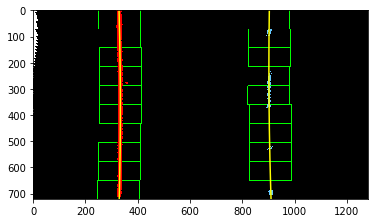

In [36]:
img = cv2.imread('./test_images/straight_lines1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

undist = cal_undistort(img, objpoints, imgpoints)

combined_binary = color_grad_thresh(undist)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "src_dst.p", "rb" ) )
src = dist_pickle["src"]
dst = dist_pickle["dst"]

# Perspective transform
binary_warped, perspective_M = corners_unwarp(combined_binary, src, dst)

# Test sliding window
left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = sliding_window(binary_warped)

# Visualization
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255

# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

rectangles = visualization_data[0]
histogram = visualization_data[1]

for rect in rectangles:
# Draw the windows on the visualization image
    cv2.rectangle(out_img,(rect[2],rect[0]),(rect[3],rect[1]),(0,255,0), 2) 
    cv2.rectangle(out_img,(rect[4],rect[0]),(rect[5],rect[1]),(0,255,0), 2) 

# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [100, 200, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

(0, 1280)

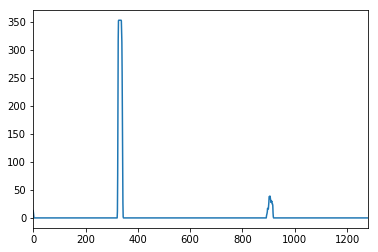

In [37]:
# Print histogram from sliding window polyfit for example image
plt.plot(histogram)
plt.xlim(0, 1280)

#### 2. Polyfit Using Fit from Previous Frame

Now we know where the lines are. In the next frame of video we don't need to do a blind search again, but instead we can just search in a margin around the previous line position.


In [38]:
# Define method to fit polynomial based on a previous fit
def polyfit_using_prev(binary_warped, left_fit_prev, right_fit_prev):
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 80
    
    left_lane_inds = ((nonzerox > (left_fit_prev[0]*(nonzeroy**2) + left_fit_prev[1]*nonzeroy + 
                    left_fit_prev[2] - margin)) & (nonzerox < (left_fit_prev[0]*(nonzeroy**2) + 
                    left_fit_prev[1]*nonzeroy + left_fit_prev[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit_prev[0]*(nonzeroy**2) + right_fit_prev[1]*nonzeroy + 
                    right_fit_prev[2] - margin)) & (nonzerox < (right_fit_prev[0]*(nonzeroy**2) + 
                    right_fit_prev[1]*nonzeroy + right_fit_prev[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit a second order polynomial to each
    if len(leftx) != 0:
        left_fit_new = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit_new = np.polyfit(righty, rightx, 2)

    return left_fit_new, right_fit_new, left_lane_inds, right_lane_inds

(720, 0)

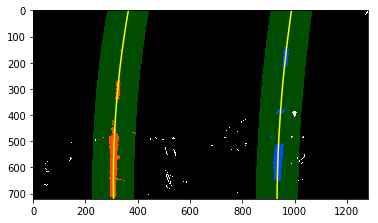

In [39]:
img = cv2.imread('./test_images/test5.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
margin = 80

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

undist = cal_undistort(img, objpoints, imgpoints)

combined_binary = color_grad_thresh(undist)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "src_dst.p", "rb" ) )
src = dist_pickle["src"]
dst = dist_pickle["dst"]

# Perspective transform
binary_warped, perspective_M = corners_unwarp(combined_binary, src, dst)

left_fit2, right_fit2, left_lane_inds2, right_lane_inds2 = polyfit_using_prev(binary_warped, left_fit, right_fit)

# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit2[0]*ploty**2 + left_fit2[1]*ploty + left_fit2[2]
right_fitx = right_fit2[0]*ploty**2 + right_fit2[1]*ploty + right_fit2[2]

# Create an image to draw on and an image to show the selection window
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
window_img = np.zeros_like(out_img)

# Color in left and right line pixels
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
out_img[nonzeroy[left_lane_inds2], nonzerox[left_lane_inds2]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds2], nonzerox[right_lane_inds2]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

## Step 5: Measuring Curvature

Compute the radius of curvature of the fit. The radius of curvature is computed according to the formula and method described in the classroom material.

In [54]:
def meaure_curvature_center(img, left_fit, right_fit, left_lane_inds, right_lane_inds):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    left_curverad, right_curverad, center_dist = (0, 0, 0)
    
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image, same as in class material
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    y_eval = np.max(ploty)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    if len(leftx) != 0 and len(rightx) != 0:
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

        # Calculate the new radi of curvature
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    if left_fit is not None and right_fit is not None:
        # Calculate distance from center
        car_position = img.shape[1]/2
        left_fit_x_int = left_fit[0]*img.shape[0]**2 + left_fit[1]*img.shape[0] + left_fit[2]
        right_fit_x_int = right_fit[0]*img.shape[0]**2 + right_fit[1]*img.shape[0] + right_fit[2]
        lane_center_position = (right_fit_x_int + left_fit_x_int) /2
        center_dist = (car_position - lane_center_position) * xm_per_pix
    
    return left_curverad, right_curverad, center_dist 
    

In [55]:
img = cv2.imread('./test_images/test5.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

undist = cal_undistort(img, objpoints, imgpoints)

combined_binary = color_grad_thresh(undist)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "src_dst.p", "rb" ) )
src = dist_pickle["src"]
dst = dist_pickle["dst"]

# Perspective transform
binary_warped, perspective_M = corners_unwarp(combined_binary, src, dst)

# Test sliding window
left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = sliding_window(binary_warped)

left_curverad, right_curverad, center_dist = meaure_curvature_center(binary_warped, left_fit, right_fit,
                                                                     left_lane_inds, right_lane_inds)

print('Radius of curvature for example:', right_curverad, 'm,', left_curverad, 'm')
print('Distance from lane center for example:', center_dist, 'm')

Radius of curvature for example: 1321.01990855 m, 1026.86607422 m
Distance from lane center for example: 0.133339362526 m


**Note:** The curvature of 1.5 km and 1.3 km is close to the 1 km mentioned in the course material

### Drawing

Now we have a good measurement of the line positions in warped space, it's time to project the measurement back down onto the road!

In [56]:
def drawing(original_img, binary_warped, left_fit, right_fit, Minv):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (binary_warped.shape[1], binary_warped.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(original_img, 1, newwarp, 0.3, 0)
    return result

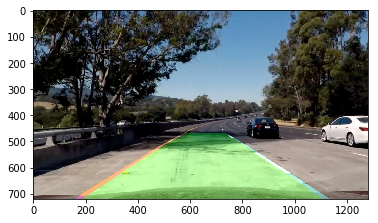

In [57]:
img = cv2.imread('./test_images/test5.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

undist = cal_undistort(img, objpoints, imgpoints)

combined_binary = color_grad_thresh(undist)

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "src_dst.p", "rb" ) )
src = dist_pickle["src"]
dst = dist_pickle["dst"]

# Perspective transform
binary_warped, perspective_M = corners_unwarp(combined_binary, src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)

# Test sliding window
left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = sliding_window(binary_warped)

output = drawing(undist, binary_warped, left_fit, right_fit, Minv)
plt.imshow(output)

### Write Curvature radius and distance from center data to img


In [58]:
def write_data(img, curve_radius, center_dist):
    new_img = np.copy(img)
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(curve_radius) + 'm'
    cv2.putText(new_img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if center_dist > 0:
        direction = 'right'
    elif center_dist < 0:
        direction = 'left'
    abs_center_dist = abs(center_dist)
    text = '{:04.3f}'.format(abs_center_dist) + 'm ' + direction + ' of center'
    cv2.putText(new_img, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    
    return new_img

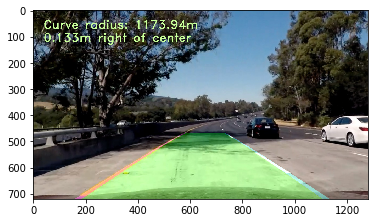

In [59]:
result = write_data(output, (right_curverad+left_curverad)/2, center_dist)
plt.imshow(result)

## Image Processing Pipeline

Combine step 1 through step 5, define image processing pipeline

In [60]:
def process_img(img):
    
    # Camera calibration
    undist = cal_undistort(img, objpoints, imgpoints)
    
    # Binary threshold
    combined_binary = color_grad_thresh(undist)

    # Read in the saved objpoints and imgpoints
    dist_pickle = pickle.load( open( "src_dst.p", "rb" ) )
    src = dist_pickle["src"]
    dst = dist_pickle["dst"]

    # Perspective transform
    binary_warped, perspective_M = corners_unwarp(combined_binary, src, dst)
    
    # Inverse trnasform
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Test sliding window
    left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = sliding_window(binary_warped)

    output = drawing(undist, binary_warped, left_fit, right_fit, Minv)
    
    left_curverad, right_curverad, center_dist = meaure_curvature_center(binary_warped, left_fit, right_fit,
                                                                     left_lane_inds, right_lane_inds)
    
    result = write_data(output, (right_curverad+left_curverad)/2, center_dist)
    
    return result


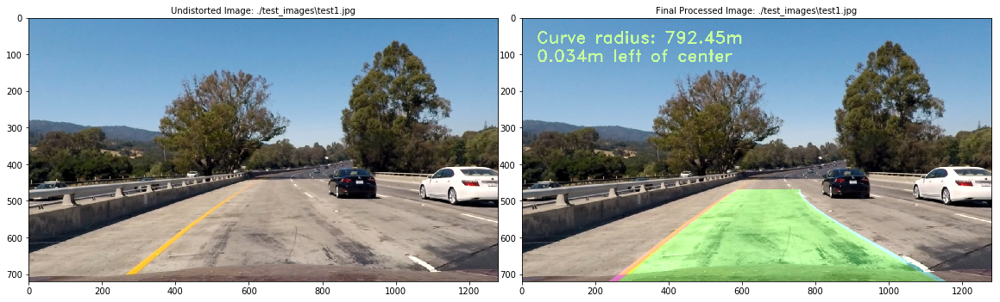

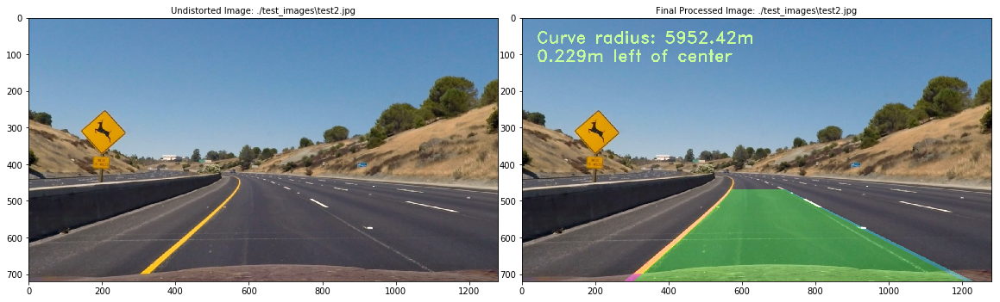

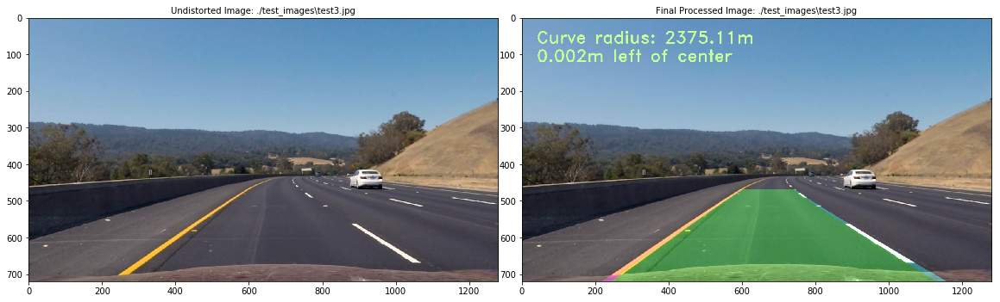

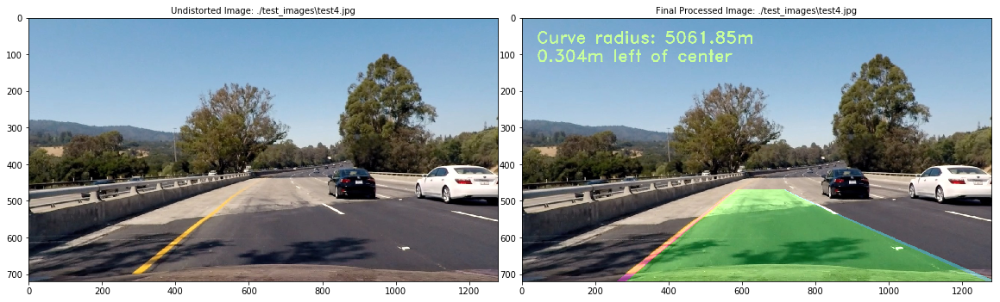

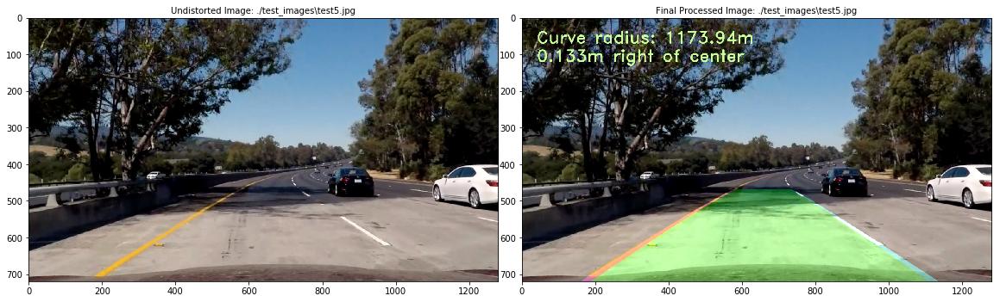

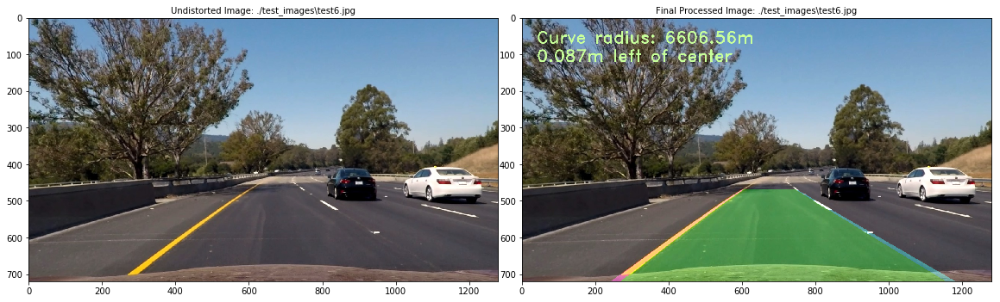

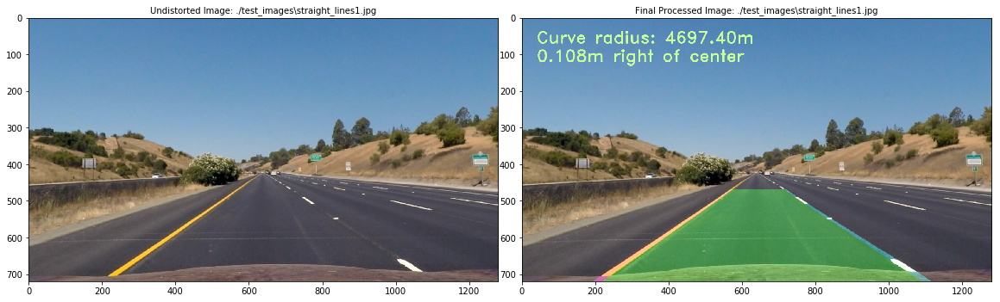

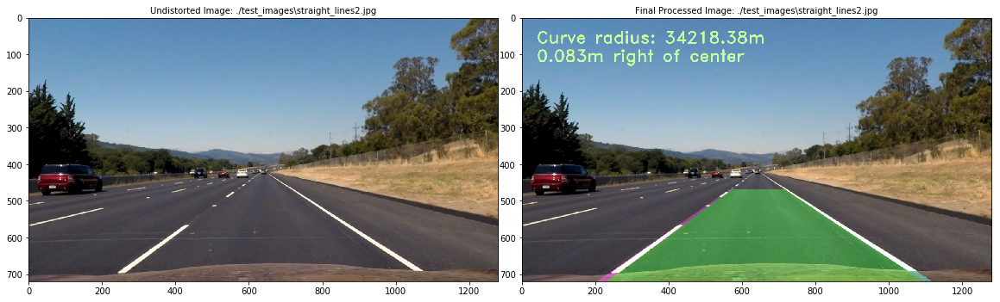

In [61]:
# Read in test images
test_imgs1 = glob.glob('./test_images/test*.jpg')
test_imgs2 = glob.glob('./test_images/straight_lines*.jpg')
test_imgs = test_imgs1 + test_imgs2

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

for i, fname in enumerate(test_imgs):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undist = cal_undistort(img, objpoints, imgpoints)
    output = process_img(img)
    
    # Visualization
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(undist)
    ax1.set_title('Undistorted Image: {}'.format(fname), fontsize=10)
    ax2.imshow(output)
    ax2.set_title('Final Processed Image: {}'.format(fname), fontsize=10)

## Define Line Class to Store Data

In [62]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration
        self.detected = False
        # polynomial coefficients averaged over the last n iterations
        self.best_fit = None
        # polynomial coefficients for the most recent fit
        self.current_fit = None
        # polynomial coefficients of the last n fits 
        self.recent_fits = [] 
        # radius of curvature of the line in some units
        self.radius_of_curvature = None
        # distance in meters of vehicle cernter from the line
        self.line_base_pos = None
        # difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
    
    def add_fit(self, fit, inds):
        # add a found fit to Line
        if fit is not None:
            if self.current_fit != None:
                # Check with most recent fit
                self.diffs = abs(fit - self.current_fit)
                if self.diffs[0] > 0.001 or self.diffs[1] > 1.0 or self.diffs[2] > 1000.:
                    # abort the bad fit if it differs from last fit a lot
                    # unless there are not fits in the current_fit
                    self.detected = False
                else:
                    self.detected = True
                    self.current_fit = fit
                    self.recent_fits.append(fit)
                    if len(self.recent_fits)>3:#store 3 most recent fits
                        self.recent_fits = self.recent_fits[len(self.recent_fits)-3:]
                    self.best_fit = np.average(self.recent_fits, axis=0)
            else: # The first fit take it
                self.detected = True
                self.current_fit = fit
                self.recent_fits.append(fit)
                if len(self.recent_fits)>3:#store 3 most recent fits
                    self.recent_fits = self.recent_fits[len(self.recent_fits)-3:]
                self.best_fit = np.average(self.recent_fits, axis=0)
        else: # no new fit is found, fit = None
            self.detected = False
        
        if self.detected == False: # No good fit found, remove the oldest fit in recent_fit
            if len(self.recent_fits) > 0:
                self.recent_fits = self.recent_fits[:len(self.recent_fits)-1]
            if len(self.recent_fits) > 0:
                # if there are still entries in recent_fits, avarge
                self.best_fit = np.average(self.recent_fits, axis=0)

In [63]:
# Sanity check for left & right lines
def sanity_check_dir(left_fit, right_fit, shape):
        
    # Check x location of both lines
    left_fit_x_int = left_fit[0]*shape[0]**2 + left_fit[1]*shape[0] + left_fit[2]
    right_fit_x_int = right_fit[0]*shape[0]**2 + right_fit[1]*shape[0] + right_fit[2]
    x_int_diff = abs(right_fit_x_int-left_fit_x_int)
    
    if abs(600 - x_int_diff) > 100:
        # two lines are two wide or close, bad lines found, discard
        left_fit = None
        right_fit = None
        
    # Check they are roughly parallel is passed x location test
    if left_fit is not None and right_fit is not None:
        diffs = abs(left_fit - right_fit)         
        if diffs[0] > 0.001 or diffs[1] > 1.0 or diffs[2] > 1000.:
            # Two lines are not parallel abort bad lines
            left_fit = None
            right_fit = None
    
    return left_fit, right_fit

## Define Video process pipeline

In [64]:
def process_vedio(img):
    # Camera calibration
    undist = cal_undistort(img, objpoints, imgpoints)
    
    # Binary threshold
    combined_binary = color_grad_thresh(undist)

    # Perspective transform
    binary_warped, perspective_M = corners_unwarp(combined_binary, src, dst)
    
    # Inverse trnasform
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # If both lanes are detected last frame, use polyfit_using_prev. Otherwise use sliding window search
    if left_line.detected == False or right_line.detected == False:
        left_fit, right_fit, left_lane_inds, right_lane_inds, visualization_data = sliding_window(binary_warped)
    else: 
        left_fit, right_fit, left_lane_inds, right_lane_inds = polyfit_using_prev(binary_warped, 
                                                            left_line.current_fit, right_line.current_fit)
    
    # Check the twos lines direction.
    if left_fit is not None and right_fit is not None:
        # Sanity check
        left_fit, right_fit = sanity_check_dir(left_fit, right_fit, img.shape)
            
    left_line.add_fit(left_fit, left_lane_inds)
    right_line.add_fit(right_fit, right_lane_inds)
    
    #print('L-best fit',left_line.best_fit)
    #print('L-current fit',left_line.current_fit)
    #print('Lfit', left_fit)
    #print('Rfit', right_fit)
    #print('diff',left_fit - right_fit)
    
    # Draw the current best fit
    if left_line.best_fit is not None and right_line.best_fit is not None:
        output = drawing(undist, binary_warped, left_line.best_fit, right_line.best_fit, Minv)
        left_curverad, right_curverad, center_dist = meaure_curvature_center(binary_warped, 
                                                        left_line.best_fit, right_line.best_fit,
                                                        left_lane_inds, right_lane_inds)
        result = write_data(output, (right_curverad+left_curverad)/2, center_dist)
    else:
        result = img
        
    return result

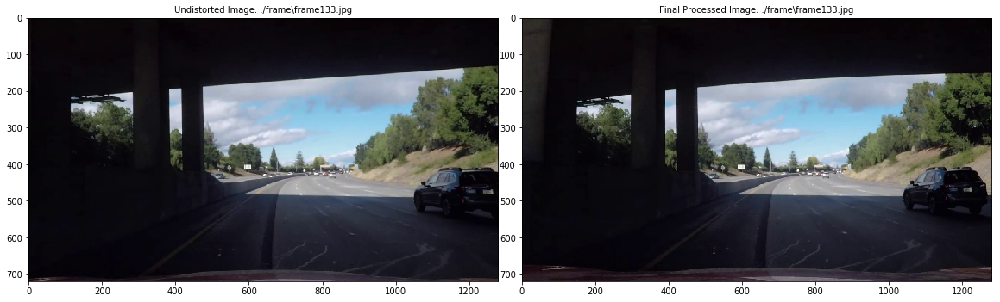

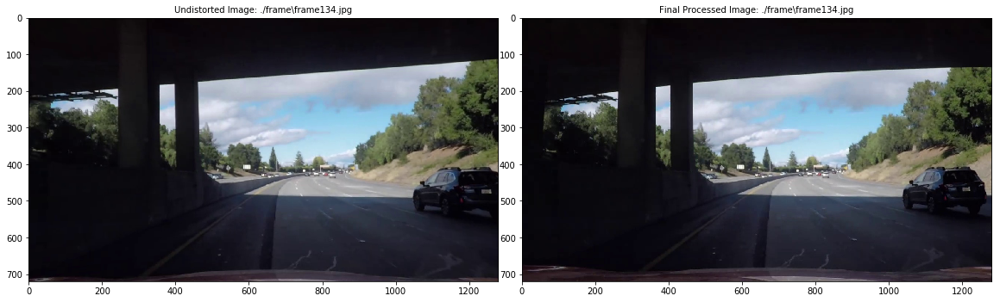

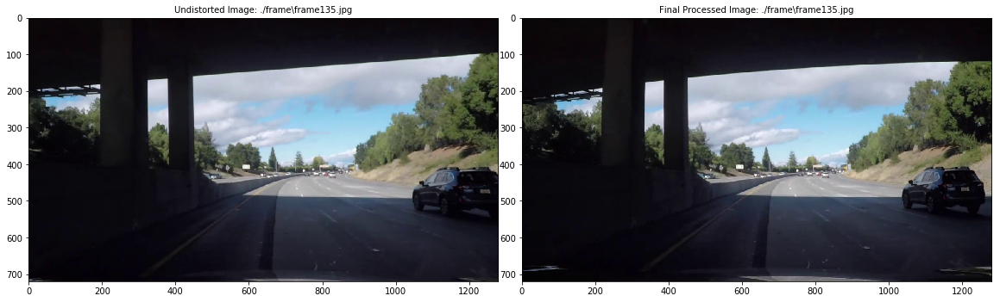

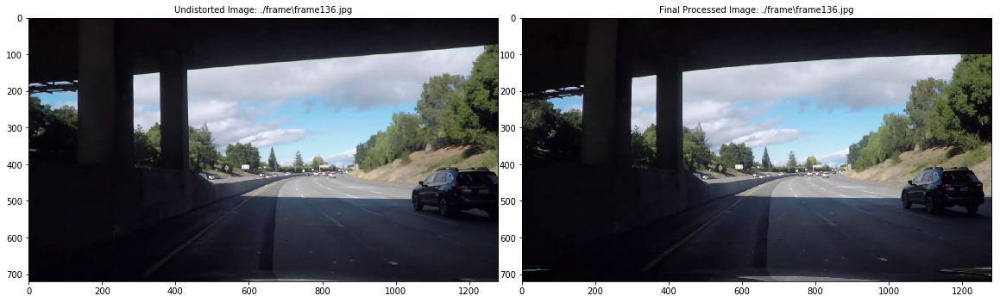

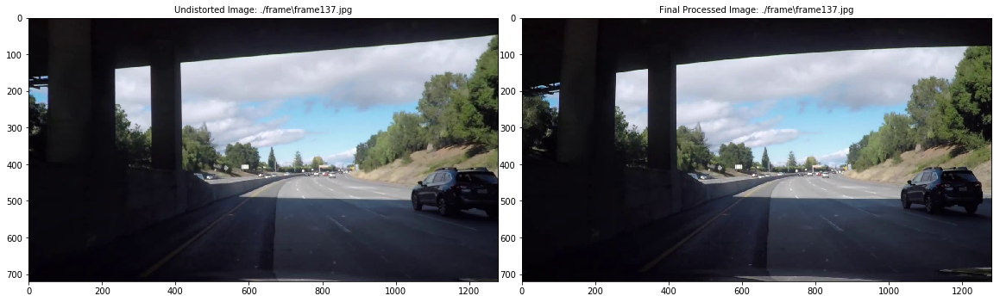

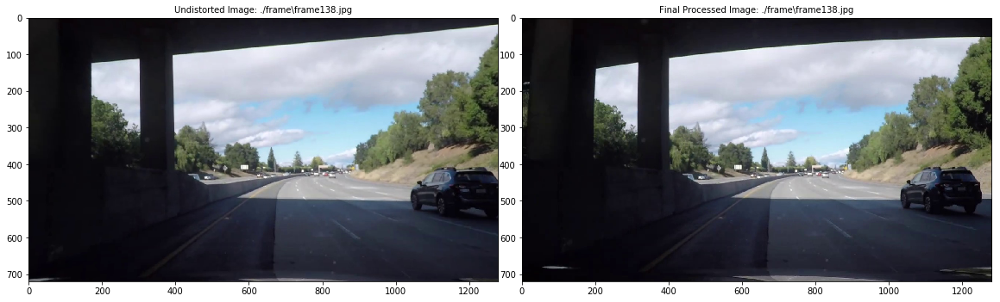

In [65]:
left_line = Line()
right_line = Line()

# Read in test images
test_imgs = glob.glob('./frame/frame*.jpg')
#test_imgs = glob.glob('./test_images/test*.jpg')
#test_imgs = ['./frame/frame1046.jpg']

# Read in the saved objpoints and imgpoints
dist_pickle = pickle.load( open( "calibration.p", "rb" ) )
objpoints = dist_pickle["objpoints"]
imgpoints = dist_pickle["imgpoints"]

for i, fname in enumerate(test_imgs):
    img = cv2.imread(fname)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undist = cal_undistort(img, objpoints, imgpoints)
    output = process_vedio(img)
    
    # Visualization
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(undist)
    ax1.set_title('Undistorted Image: {}'.format(fname), fontsize=10)
    ax2.imshow(output)
    ax2.set_title('Final Processed Image: {}'.format(fname), fontsize=10)

## Process Project Video

In [68]:
left_line = Line()
right_line = Line()
video_output1 = 'project_video_output.mp4'
video_input1 = VideoFileClip('project_video.mp4')
processed_video = video_input1.fl_image(process_vedio)
%time processed_video.write_videofile(video_output1, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4



  5%|████▎                                                                           | 67/1261 [00:52<15:05,  1.32it/s]


 11%|████████▍                                                                      | 135/1261 [01:44<14:15,  1.32it/s]


 16%|████████████▋                                                                  | 203/1261 [02:35<13:20,  1.32it/s]


 21%|████████████████▉                                                              | 271/1261 [03:30<12:58,  1.27it/s]


 27%|█████████████████████▏                                                         | 339/1261 [04:24<12:21,  1.24it/s]


 32%|█████████████████████████▍                                                     | 407/1261 [05:19<12:03,  1.18it/s]


 38%|█████████████████████████████▊                                                 | 475/1261 [06:14<10:20,  1.27it/s]


 43%|██████████████████████████████████                                             | 543/1261 [07:09<09:35,  1.25it/s]


 48%|██████████████████████████████████████▎                                        | 611/1261 [08:04<08:35,  1.26it/s]


 54%|██████████████████████████████████████████▌                                    | 679/1261 [09:00<07:56,  1.22it/s]


 59%|██████████████████████████████████████████████▊                                | 747/1261 [09:55<07:25,  1.15it/s]


 65%|███████████████████████████████████████████████████                            | 815/1261 [10:50<05:56,  1.25it/s]


 70%|███████████████████████████████████████████████████████▎                       | 883/1261 [11:45<05:06,  1.23it/s]


 75%|███████████████████████████████████████████████████████████▌                   | 951/1261 [12:40<04:07,  1.25it/s]


 81%|███████████████████████████████████████████████████████████████               | 1019/1261 [13:35<03:13,  1.25it/s]


 86%|███████████████████████████████████████████████████████████████████▏          | 1087/1261 [14:30<02:18,  1.25it/s]


 92%|███████████████████████████████████████████████████████████████████████▍      | 1155/1261 [15:24<01:23,  1.26it/s]


 97%|███████████████████████████████████████████████████████████████████████████▋  | 1223/1261 [16:19<00:30,  1.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [16:48<00:00,  1.27it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

Wall time: 16min 49s


## Process Challenge Video

In [69]:
left_line = Line()
right_line = Line()
video_output1 = 'challenge_video_output.mp4'
video_input1 = VideoFileClip('challenge_video.mp4')
processed_video = video_input1.fl_image(process_vedio)
%time processed_video.write_videofile(video_output1, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4



 14%|███████████▏                                                                     | 67/485 [00:52<05:22,  1.30it/s]


 28%|██████████████████████▎                                                         | 135/485 [01:44<04:24,  1.32it/s]


 42%|█████████████████████████████████▍                                              | 203/485 [02:38<03:54,  1.20it/s]


 56%|████████████████████████████████████████████▋                                   | 271/485 [03:33<02:48,  1.27it/s]


 70%|███████████████████████████████████████████████████████▉                        | 339/485 [04:28<02:01,  1.20it/s]


 84%|███████████████████████████████████████████████████████████████████▏            | 407/485 [05:24<01:02,  1.25it/s]


 98%|██████████████████████████████████████████████████████████████████████████████▎ | 475/485 [06:18<00:07,  1.26it/s]


100%|████████████████████████████████████████████████████████████████████████████████| 485/485 [06:26<00:00,  1.26it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

Wall time: 6min 27s


In [ ]:
cap = cv2.VideoCapture("project_video.mp4")
total_frames = cap.get(7)
print(total_frames)
success, img = cap.read()
count = 0
success = True
while success:
    success,img = cap.read()
    if (count > 612) & (count < 616):
        cv2.imwrite("./frame/frame%d.jpg" % count, img)     # save frame as JPEG file
    count += 1